In [1]:
import os
import cv2 as cv
import matplotlib.pyplot as plt
import json
import random
import shutil
from ultralytics import YOLO
import torch
from PIL import Image

Обработка исходных данных

In [2]:
def show_image_with_boxes(img_path, annotation_path):
    image = cv.imread(img_path)
    image = cv.cvtColor(image, cv.COLOR_BGR2RGB)
    H, W, _ =image.shape

    with open(annotation_path, 'r') as f:
        lines = f.readlines()
    for line in lines:
        _, x, y, width, heigth = map(float, line.split(" "))
        pt1 = (int((x-width/2)*W), int((y-heigth/2)*H))
        pt2 = (int((x+width/2)*W), int((y+heigth/2)*H))
        cv.rectangle(image, pt1, pt2, (255,0,0), 3)

    plt.figure(figsize=(10,10))
    plt.imshow(image)
    plt.axis("off")
    plt.show()

In [3]:
image_folder_path = r"D:\mchs_project\images"

In [4]:
images = [img for img in os.listdir('images') if img.endswith(".jpg")]

In [5]:
random_images = random.sample(images, 2)

D:\mchs_project\images\b6d7f7b1-62.jpg


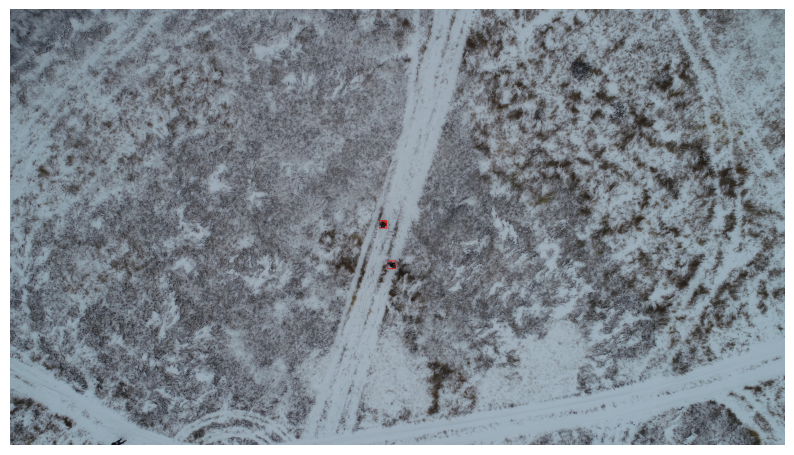

D:\mchs_project\images\1776d6b8-24.jpg


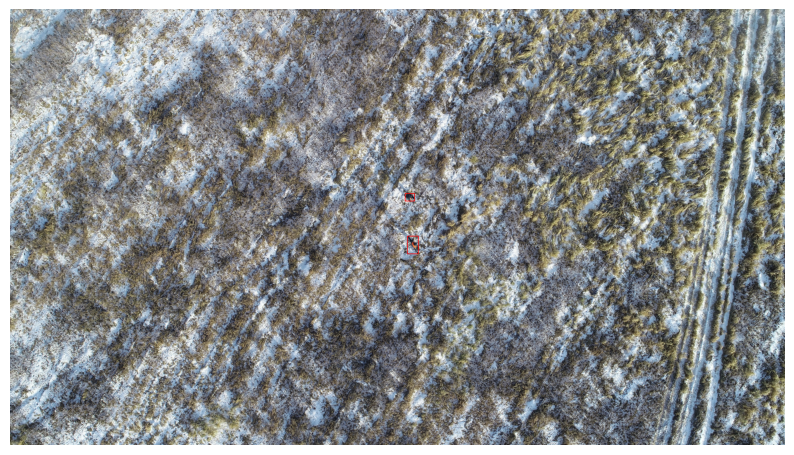

In [6]:
for img_file in random_images:
    img_path = os.path.join(image_folder_path, img_file)
    annotation_path = img_path.replace(".jpg", ".txt")
    print(img_path)
    show_image_with_boxes(img_path, annotation_path)

Визуальное сравнение изначального изображения со сжатым изображением 1024 на 1024 пикселя

(3078, 5472, 3)
(1024, 1024, 3)


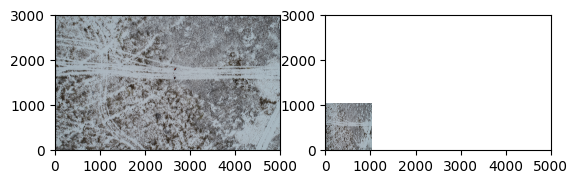

In [26]:

plt.subplot(1,2,1)
img1 = cv.imread("D:/dataset/Drone_photos_dataset/1030.jpg")
img1 = cv.cvtColor(img1, cv.COLOR_BGR2RGB)
print(img1.shape)
plt.ylim(0,3000)
plt.xlim(0,5000)
plt.imshow(img1)
img1 = cv.resize(img1, (1024, 1024), 
               interpolation = cv.INTER_LINEAR)
print(img1.shape)
plt.subplot(1,2,2)
plt.ylim(0,3000)
plt.xlim(0,5000)
plt.imshow(img1)
plt.show()

In [ ]:
# Параметры нарезки
patch_size = 1024
stride = 512  # Шаг нарезки

# Функция для нарезки изображения на патчи
def slice_image(image, patch_size, stride):
    patches = []
    h, w, _ = image.shape
    for y in range(0, h - patch_size + 1, stride):
        for x in range(0, w - patch_size + 1, stride):
            patch = image[y:y + patch_size, x:x + patch_size]
            patches.append((patch, x, y))
    return patches

# Функция для обновления координат боксов для патча
def update_boxes_for_patch(boxes, x_offset, y_offset, patch_size, img_width, img_height):
    updated_boxes = []
    for (x, y, w, h) in boxes:
        # Переводим координаты бокса в систему координат патча
        xmin_patch = (x-w/2)*img_width - x_offset
        ymin_patch = (y-h/2)*img_height - y_offset
        xmax_patch = (x+w/2)*img_width - x_offset
        ymax_patch = (y+h/2)*img_height - y_offset
        
        # Проверяем, попадает ли бокс в границы патча
        if (0 <= xmin_patch <= patch_size and 0 <= ymin_patch <= patch_size and 
            0 <= xmax_patch <= patch_size and 0 <= ymax_patch <= patch_size):
            updated_boxes.append(((x*img_width-x_offset)/patch_size, (y*img_height - y_offset)/patch_size, w*img_width/patch_size, h*img_height/patch_size))
    
    return updated_boxes

# Функция для сохранения патчей и обновленной разметки
def save_patches(image_file, annotation_file, save_dir):
    image_path = os.path.join(image_folder_path, image_file)
    image = cv.imread(image_path)
    image = cv.cvtColor(image, cv.COLOR_BGR2RGB)
    H,W,_ = image.shape
    
    patches = slice_image(image, patch_size, stride)
    annotation_path = os.path.join(image_folder_path, annotation_file)
    with open(annotation_path, "r") as f:
        boxes = [list(map(float, box.split(" ")[1:])) for box in f.readlines()]
    
    for i, (patch, x_offset, y_offset) in enumerate(patches):
        patch_boxes = update_boxes_for_patch(boxes, x_offset, y_offset, patch_size, W, H)
        
        if len(patch_boxes) > 0:  # Сохраняем только патчи с людьми
            patch_name = f"{image_file.replace('.jpg', '')}_patch_{i}.jpg"
            patch_path = os.path.join(save_dir, patch_name)
            cv.imwrite(patch_path, cv.cvtColor(patch, cv.COLOR_RGB2BGR))
            
            # Также нужно сохранить соответствующую разметку для каждого патча
            annotation_file = patch_path.replace('.jpg', '.txt')
            with open(annotation_file, 'w') as f:
                for (x, y, w, h) in patch_boxes:
                    f.write(f"0 {x} {y} {w} {h}\n")  # '0' - класс человек

# Папка для сохранения нарезанных изображений и разметок
save_dir = r"D:\mchs_project\sliced_images"
os.makedirs(save_dir, exist_ok=True)

for image_file in images:   
    annotation_file = image_file.replace(".jpg", ".txt")
    save_patches(image_file, annotation_file, save_dir)

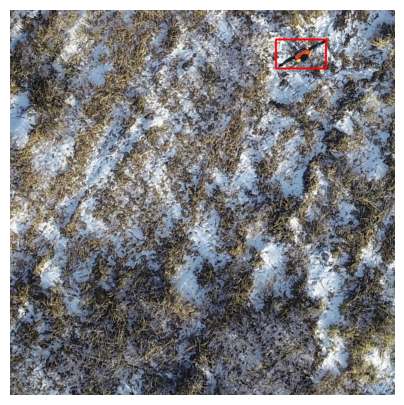

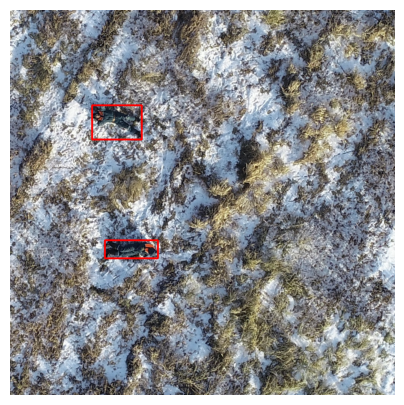

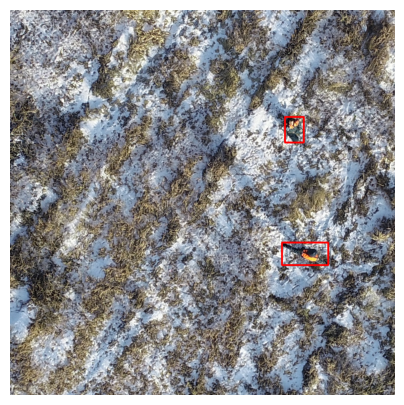

In [8]:
def read_sliced_image_annotation(annotation_path):
    boxes = []
    with open(annotation_path, 'r') as f:
        for line in f:
            line = line.rstrip('\n')
            x = float(line.split(' ')[1])
            y = float(line.split(' ')[2])
            w = float(line.split(' ')[3])
            h = float(line.split(' ')[4])
            boxes.append((x,y,w,h))
    return boxes

def show_sliced_image_with_boxes(image_path, annotation_path):
    image = cv.imread(image_path)
    image = cv.cvtColor(image, cv.COLOR_BGR2RGB)
    H,W,_=image.shape

    boxes = read_sliced_image_annotation(annotation_path)
    for (x,y,w,h) in boxes:
        cv.rectangle(image, (int((x-w/2)*W),int((y-h/2)*H)), (int((x+w/2)*W),int((y+h/2)*H)), (255, 0, 0), 3)

    plt.figure(figsize=(5,5))
    plt.imshow(image)
    plt.axis("off")
    plt.show()

sliced_images = [img for img in os.listdir("sliced_images") if img.endswith(".jpg")]
random_sliced_images = random.sample(sliced_images, 3)

for img_file in random_sliced_images:
    img_path = os.path.join(save_dir, img_file)
    annotation_path = img_path[:-4] + ".txt"
    show_sliced_image_with_boxes(img_path, annotation_path)


Обучающая выборка: 978 изображений
Тестовая выборка: 245 изображений


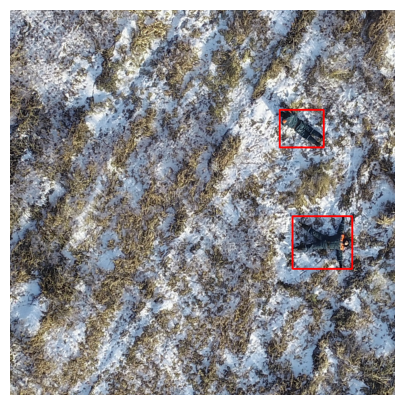

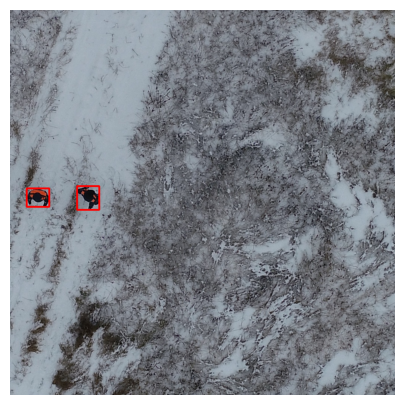

In [ ]:
train_folder = r"D:\mchs_project\train_data"
val_folder = r"D:\mchs_project\val_data"
shutil.rmtree(train_folder)
os.makedirs(train_folder, exist_ok=True)
shutil.rmtree(val_folder)
os.makedirs(val_folder, exist_ok=True)

train_ratio = 0.8

random.shuffle(sliced_images)

train_size = int(len(sliced_images) * train_ratio)
train_images = sliced_images[:train_size]
val_images = sliced_images[train_size:]

# Функция для копирования изображений и аннотаций
def copy_files(image_list, source_folder, dest_folder):
    for image_file in image_list:
        # Путь к изображению и аннотации
        image_path = os.path.join(source_folder, image_file)
        annotation_path = image_path.replace('.jpg', '.txt')

        # Убедимся, что копируем файлы в разные папки
        if not os.path.exists(os.path.join(dest_folder, image_file)):
            shutil.copy(image_path, os.path.join(dest_folder, image_file))

        # Копируем аннотацию, если она существует и не копируется в ту же папку
        if os.path.exists(annotation_path):
            dest_annotation_path = os.path.join(dest_folder, os.path.basename(annotation_path))
            if not os.path.exists(dest_annotation_path):
                shutil.copy(annotation_path, dest_annotation_path)

copy_files(train_images, save_dir, train_folder)
print(f"Обучающая выборка: {len(train_images)} изображений")

copy_files(val_images, save_dir, val_folder)
print(f"Тестовая выборка: {len(val_images)} изображений")

train_images = [img for img in os.listdir(train_folder) if img.endswith('.jpg')]
val_images = [img for img in os.listdir(val_folder) if img.endswith('.jpg')]

rnd_train_images = random.sample(train_images, 1)
rnd_val_images = random.sample(val_images, 1)

for img_file in rnd_train_images:
    img_path = os.path.join(save_dir, img_file)
    annotation_path = img_path[:-4] + ".txt"
    show_sliced_image_with_boxes(img_path, annotation_path)

for img_file in rnd_val_images:
    img_path = os.path.join(save_dir, img_file)
    annotation_path = img_path[:-4] + ".txt"
    show_sliced_image_with_boxes(img_path, annotation_path)

Обучение

In [11]:
import torch
torch.cuda.is_available()


True

In [ ]:
import os

model = YOLO("yolov5n.pt")
results = model.train(data="data.yaml", epochs=20, imgsz=1024, batch=4, device=0)

PRO TIP  Replace 'model=yolov5n.pt' with new 'model=yolov5nu.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.

Ultralytics 8.3.38  Python-3.9.8 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050, 8192MiB)
engine\trainer: task=detect, mode=train, model=yolov5n.pt, data=data.yaml, epochs=20, time=None, patience=100, batch=4, imgsz=1024, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train13, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_strid

train: Scanning D:\mchs_project\train_data.cache... 978 images, 0 backgrounds, 0 corrupt: 100%|██████████| 978/978 [00:
val: Scanning D:\mchs_project\val_data.cache... 245 images, 0 backgrounds, 0 corrupt: 100%|██████████| 245/245 [00:00<?


Plotting labels to runs\detect\train13\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 69 weight(decay=0.0), 76 weight(decay=0.0005), 75 bias(decay=0.0)
Image sizes 1024 train, 1024 val
Using 8 dataloader workers
Logging results to runs\detect\train13
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      1.55G     0.9417      2.749     0.9762          2       1024: 100%|██████████| 245/245 [00:30<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:03

                   all        245        350      0.922      0.946      0.975      0.794



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      1.54G     0.8621      1.901     0.9359          2       1024: 100%|██████████| 245/245 [00:29<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:03


                   all        245        350      0.972      0.974       0.99      0.811

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20       1.5G     0.8447      1.329       0.95          1       1024: 100%|██████████| 245/245 [00:30<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:03

                   all        245        350       0.96      0.986      0.989      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      1.51G     0.8182     0.9481      0.942          7       1024: 100%|██████████| 245/245 [00:29<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:02

                   all        245        350      0.975      0.995      0.993       0.82



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      1.51G     0.7977     0.7594     0.9344          9       1024: 100%|██████████| 245/245 [00:29<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:02

                   all        245        350       0.98          1      0.991      0.841



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      1.51G     0.7679     0.6542     0.9309          1       1024: 100%|██████████| 245/245 [00:30<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:02

                   all        245        350      0.989      0.994      0.994      0.842



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      1.51G     0.7238     0.6107     0.9009          9       1024: 100%|██████████| 245/245 [00:29<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:02

                   all        245        350      0.983      0.991      0.987      0.859



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      1.51G     0.7119     0.5589     0.9006          1       1024: 100%|██████████| 245/245 [00:30<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:02

                   all        245        350      0.978      0.999      0.991      0.851



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      1.51G     0.6957      0.533     0.9018          3       1024: 100%|██████████| 245/245 [00:29<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:02

                   all        245        350       0.99          1      0.994      0.879



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      1.51G     0.6795     0.5128     0.8943          3       1024: 100%|██████████| 245/245 [00:29<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:02

                   all        245        350      0.994          1      0.994      0.884


Closing dataloader mosaic


In [5]:
model = YOLO("D:/mchs_project/runs/detect/train13/weights/last.pt")  # load a partially trained model

# Resume training
results = model.train(resume=True)

Ultralytics 8.3.38  Python-3.9.8 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050, 8192MiB)
engine\trainer: task=detect, mode=train, model=D:\mchs_project\runs\detect\train13\weights\last.pt, data=data.yaml, epochs=20, time=None, patience=100, batch=4, imgsz=1024, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train13, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=D:\mchs_project\runs\detect\train13\weights\last.pt, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False

train: Scanning D:\mchs_project\train_data.cache... 978 images, 0 backgrounds, 0 corrupt: 100%|██████████| 978/978 [00:
val: Scanning D:\mchs_project\val_data.cache... 245 images, 0 backgrounds, 0 corrupt: 100%|██████████| 245/245 [00:00<?


Plotting labels to runs\detect\train13\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 69 weight(decay=0.0), 76 weight(decay=0.0005), 75 bias(decay=0.0)
Resuming training D:\mchs_project\runs\detect\train13\weights\last.pt from epoch 11 to 20 total epochs
Image sizes 1024 train, 1024 val
Using 8 dataloader workers
Logging results to runs\detect\train13
Starting training for 20 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20       1.5G        nan        nan        nan          3       1024: 100%|██████████| 245/245 [00:27<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:02


                   all        245        350      0.993          1      0.994      0.874

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      1.54G        nan        nan        nan          3       1024: 100%|██████████| 245/245 [00:27<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:02

                   all        245        350      0.991          1      0.994      0.875



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      1.51G        nan        nan        nan          2       1024: 100%|██████████| 245/245 [00:26<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:02

                   all        245        350       0.99          1      0.994      0.871



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      1.51G        nan        nan        nan          2       1024: 100%|██████████| 245/245 [00:27<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:02

                   all        245        350      0.994          1      0.994       0.87



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      1.51G        nan        nan        nan          1       1024: 100%|██████████| 245/245 [00:29<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:02

                   all        245        350      0.994          1      0.994      0.873



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      1.54G        nan        nan        nan          1       1024: 100%|██████████| 245/245 [00:29<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:02

                   all        245        350      0.993          1      0.994      0.875



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      1.54G        nan        nan        nan          2       1024: 100%|██████████| 245/245 [00:28<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:02

                   all        245        350      0.993          1      0.994      0.875



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      1.54G        nan        nan        nan          2       1024: 100%|██████████| 245/245 [00:29<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:02


                   all        245        350      0.994          1      0.994      0.873

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      1.54G        nan        nan        nan          3       1024: 100%|██████████| 245/245 [00:29<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:02

                   all        245        350      0.993          1      0.994       0.87



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20       1.5G        nan        nan        nan          2       1024: 100%|██████████| 245/245 [00:29<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:02

                   all        245        350      0.993          1      0.994      0.872



10 epochs completed in 0.093 hours.
Optimizer stripped from runs\detect\train13\weights\last.pt, 5.3MB
Optimizer stripped from runs\detect\train13\weights\best.pt, 5.3MB

Validating runs\detect\train13\weights\best.pt...
Ultralytics 8.3.38  Python-3.9.8 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3050, 8192MiB)
YOLOv5n summary (fused): 193 layers, 2,503,139 parameters, 0 gradients, 7.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 31/31 [00:02


                   all        245        350      0.994          1      0.994      0.886
Speed: 0.6ms preprocess, 7.4ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs\detect\train13


Тестирование

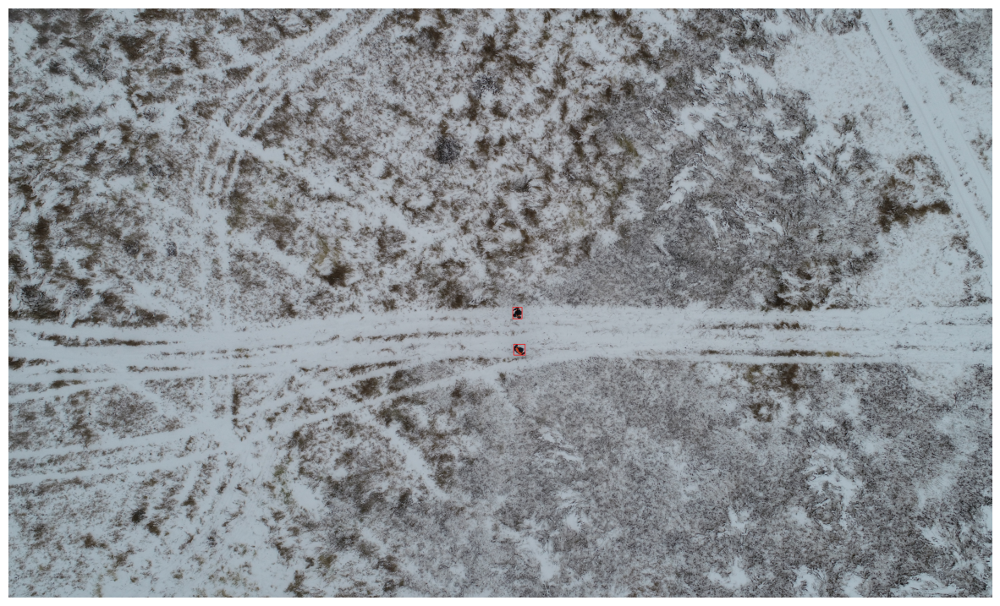

D:/dataset/Drone_photos_dataset\3542.jpg


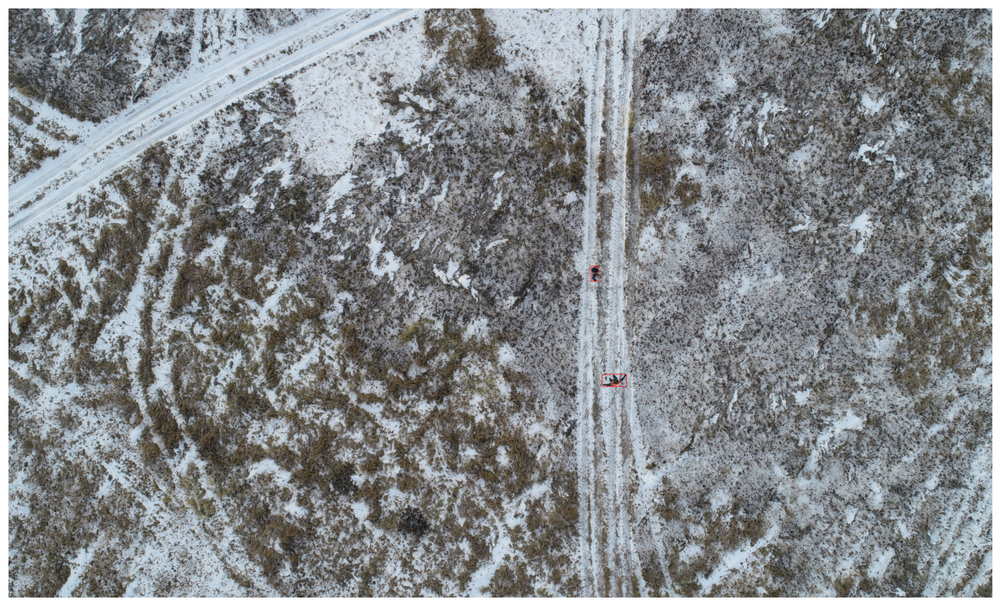

D:/dataset/Drone_photos_dataset\1013.jpg


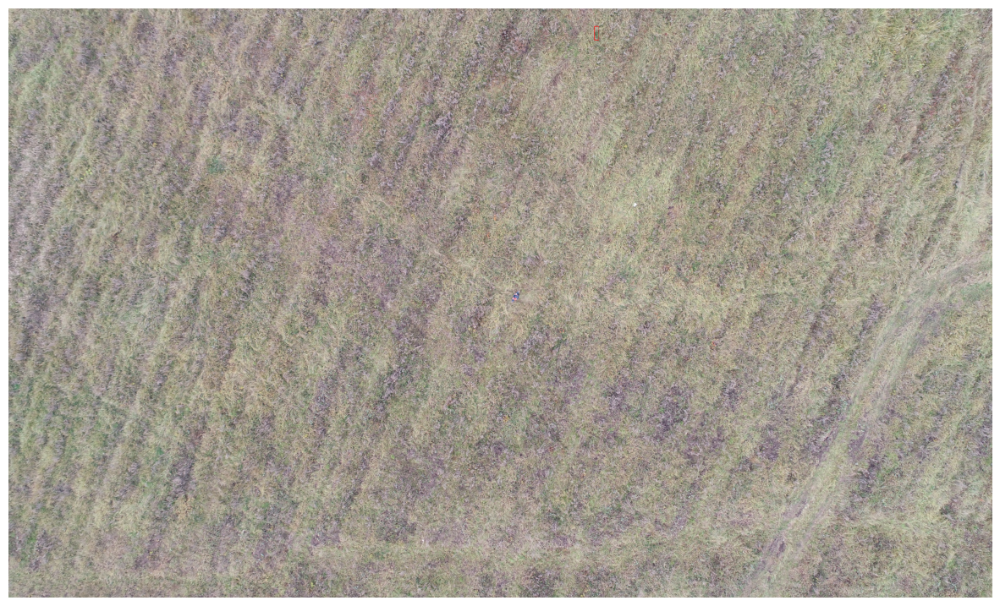

D:/dataset/Drone_photos_dataset\2353.jpg


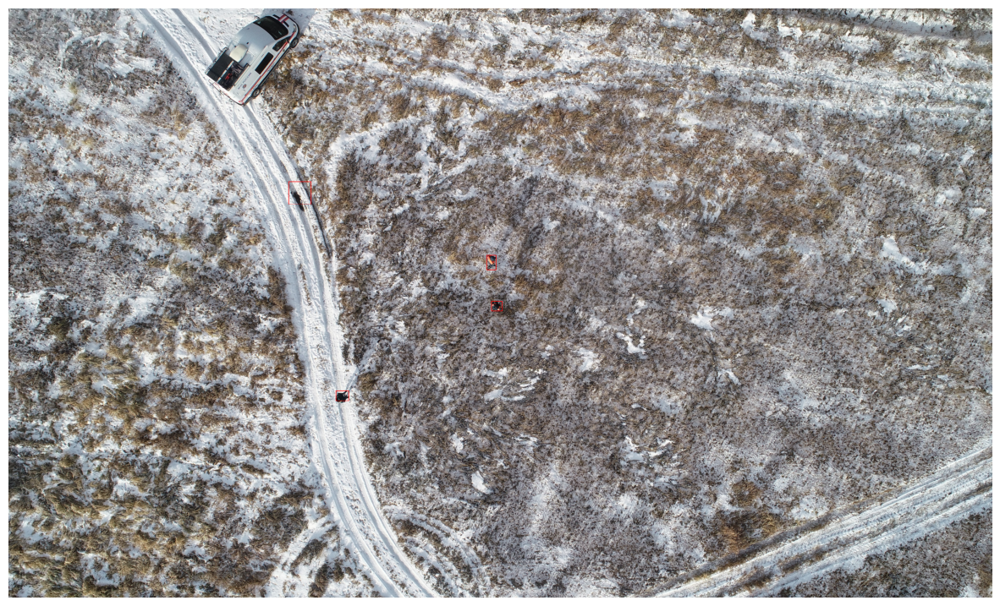

D:/dataset/Drone_photos_dataset\3609.jpg


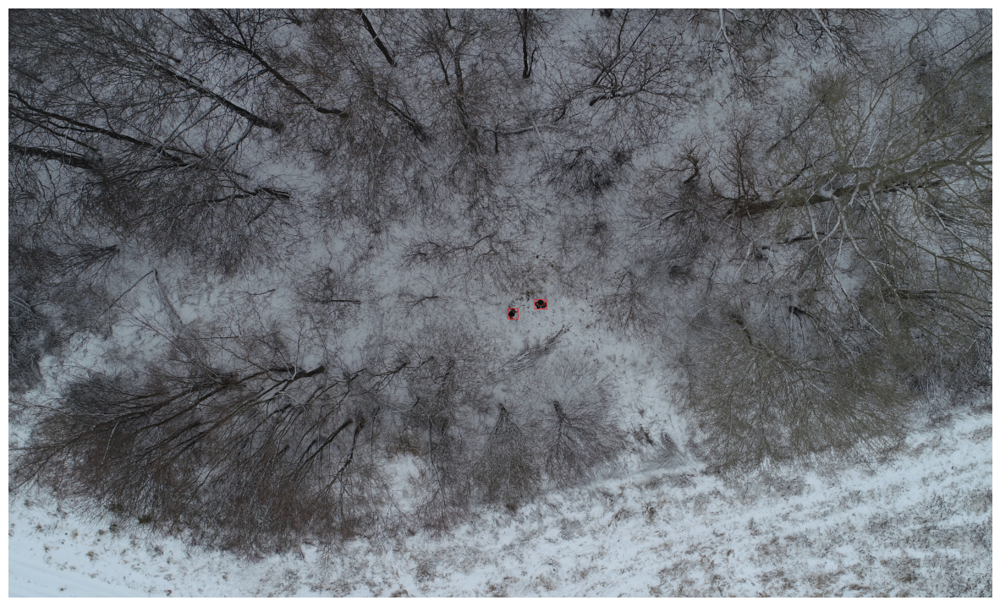

D:/dataset/Drone_photos_dataset\2718.jpg


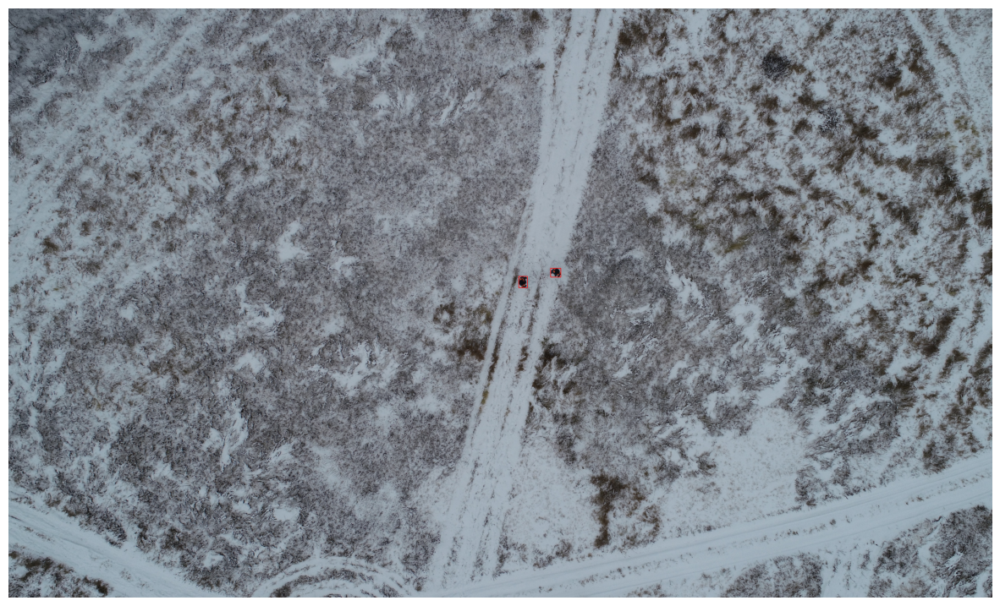

In [ ]:
model = YOLO('D:/mchs_project/runs/detect/train13/weights/best.pt')

patch_size = 1024
stride = 1024  # Шаг нарезки

def slice_image(image, patch_size, stride):
    patches = []
    h, w, _ = image.shape
    for y in range(0, h - patch_size + 1, stride):
        for x in range(0, w - patch_size + 1, stride):
            patch = image[y:y + patch_size, x:x + patch_size]
            patches.append((patch, x, y))
    return patches

def detect_image(image_path):
    # Загрузка изображения
    img = cv.imread(image_path)
    img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
    H,W,_ = img.shape
    original_height, original_width = img.shape[:2]  # исходные размеры изображения

    patches = slice_image(img, patch_size, stride)
    for patch,x,y in patches:
        # Запуск детекции на патче
        img = Image.fromarray(patch)
        results = model(img, verbose=False)
        # Извлечение результатов
        detections = [(result.boxes.xywh, result.boxes.conf, result.boxes.cls) for result in results]  # координаты bbox в формате [xmin, ymin, xmax, ymax, confidence, class]

        if len(detections[0][0]) == 0:
            continue
    
        # Отображение результатов с коррекцией масштаба для уменьшенного изображения
        for xywh, conf, cls in detections:
            for coords in xywh:
                label = str(conf)
                cv.rectangle(patch, (int(coords[0]-coords[2]/2), int(coords[1]-coords[3]/2)), (int(coords[0]+coords[2]/2), int(coords[1]+coords[3]/2)), (255, 0, 0), 2)

        
    # Склеивание патчей в единое изображение с учетом боксов, найденных людей 
    final_h_images = []
    final_image = None
    for y in range(len(range(0, H - patch_size + 1, stride))):
        for x in range(len(range(0, W - patch_size + 1, stride))):
            if x==0:
                final_image = patches[y*len(range(0, W - patch_size + 1, stride))][0]
            else:
                final_image = cv.hconcat([final_image, patches[y*len(range(0, W - patch_size + 1, stride))+x][0]]) 
        final_h_images.append(final_image) 
    result = cv.vconcat(final_h_images)
    plt.figure(figsize=(15,15))
    result = Image.fromarray(result)
    plt.imshow(result)
    plt.axis("off")
    plt.show()

detect_image('D:/dataset/Drone_photos_dataset/1030.jpg')

test_images_path = "D:/dataset/Drone_photos_dataset"
test_images = [img for img in os.listdir(test_images_path)]
rnd_test_images = random.sample(test_images, 5)

for img in rnd_test_images:
    print(os.path.join(test_images_path, img))
    detect_image(os.path.join(test_images_path, img))